# Creating the dataset

In [2]:
import pandas as pd

# load data
#df = pd.read_csv('/content/Dataset_final_for_LLM.csv')
df_test = pd.read_csv('/content/Dataset_final_for_LLM_test.csv')


In [ ]:
#df.drop('Unnamed: 0', axis=1, inplace=True)
df_test.drop('Unnamed: 0', axis=1, inplace=True)
df_test

,0,1,2,3,4,5,6,7,8,9,...,13,14,15,16,17,18,19,20,21,Text
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,takeoff runway loudnoise hear come front area ...
1,0,0,0,0,1,0,0,0,0,1,...,0,0,0,0,0,1,0,0,0,taxi parkingramp brake system fail stop aircra...
2,1,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,airworthinessdirective due hour grease blower ...
3,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,descend clear feetcaptain set foot alerti read...
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,1,0,0,unusual odor note cockpit flightcrewa minute l...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7072,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,attempt make short mile flight return homebase...
7073,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,incident groundproximitywarningsystem mode war...
7074,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,encounter sever downdraft microburst cause pla...
7075,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,weather reroute minute hold west iah airport c...


The data that we dispose of is a data frame with 22 binary classes and the text that describes an aviation incident

In [ ]:
# create a list that contains the labels, as well as 2 dictionaries that map labels to integers and back.
labels = [label for label in df.columns if label not in ['Text']]
id2label = {idx:label for idx, label in enumerate(labels)}
label2id = {label:idx for idx, label in enumerate(labels)}
labels

['0',
 '1',
 '2',
 '3',
 '4',
 '5',
 '6',
 '7',
 '8',
 '9',
 '10',
 '11',
 '12',
 '13',
 '14',
 '15',
 '16',
 '17',
 '18',
 '19',
 '20',
 '21']

In [ ]:
from sklearn.model_selection import train_test_split

# creat the validation data with teh split
train_df, val_df = train_test_split(df, test_size=0create a list that contains the labels, as well as 2 dictionaries that map labels to integers and back..3, random_state=42)


In [ ]:
from datasets import Dataset, DatasetDict

train_dataset = Dataset.from_pandas(train_df.reset_index(drop=True))
val_dataset = Dataset.from_pandas(val_df.reset_index(drop=True))
test_dataset = Dataset.from_pandas(df_test.reset_index(drop=True))

# Création du DatasetDict
dataset_dict= DatasetDict({
    "train": train_dataset,
    "validation": val_dataset,
    "test": test_dataset
})



Let's check our dataset

In [ ]:
dataset_dict

DatasetDict({
    train: Dataset({
        features: ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', 'Text'],
        num_rows: 15063
    })
    validation: Dataset({
        features: ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', 'Text'],
        num_rows: 6456
    })
    test: Dataset({
        features: ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', 'Text'],
        num_rows: 7077
    })
})

We want to see the frequence of each class in the train validation and test data

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def plot_all_label_frequencies(dataset):
    splits = ['train', 'validation', 'test']
    num_classes = len(dataset['train'][0]['labels'])  # suppose que labels = vecteur binaire

    plt.figure(figsize=(16, 10))

    for i, split in enumerate(splits, 1):
        if split in dataset:
            labels = np.array(dataset[split]['labels'])  # shape: (num_samples, num_classes)
            class_counts = labels.sum(axis=0)

            plt.subplot(3, 1, i)
            sns.barplot(x=np.arange(num_classes), y=class_counts, palette="Blues_d")
            plt.title(f"Fréquence des classes dans {split}")
            plt.xlabel("Classe")
            plt.ylabel("Nombre d'occurrences")
            plt.xticks(np.arange(num_classes))

    plt.tight_layout()
    plt.show()


<ipython-input-70-08464b150077>:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=np.arange(num_classes), y=class_counts, palette="Blues_d")
<ipython-input-70-08464b150077>:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=np.arange(num_classes), y=class_counts, palette="Blues_d")
<ipython-input-70-08464b150077>:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=np.arange(num_classes), y=class_counts, palette="Blues_d")


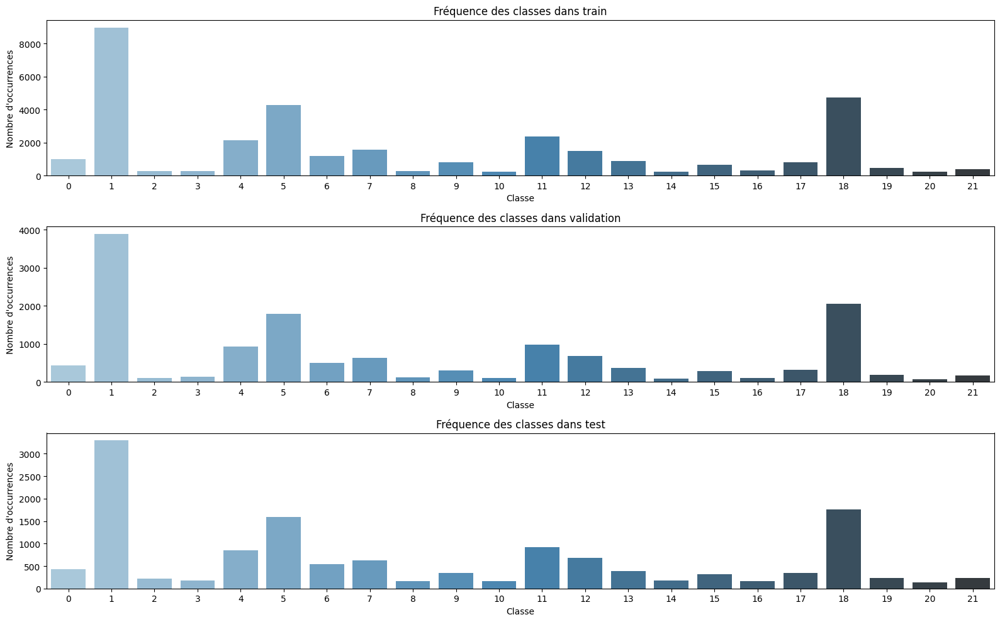

In [ ]:
plot_all_label_frequencies(encoded_dataset)  # ou dataset


For multi-label text classification, this is a matrix of shape (batch_size, num_labels).

In [ ]:
from transformers import AutoTokenizer
import numpy as np

tokenizer = AutoTokenizer.from_pretrained("bert-base-uncased")

def preprocess_data(examples):
  # take a batch of texts
  text = examples["Text"]
  # encode them
  encoding = tokenizer(text, padding="max_length", truncation=True, max_length=512)
  # add labels
  labels_batch = {k: examples[k] for k in examples.keys() if k in labels}
  # create numpy array of shape (batch_size, num_labels)
  labels_matrix = np.zeros((len(text), len(labels)))
  # fill numpy array
  for idx, label in enumerate(labels):
    labels_matrix[:, idx] = labels_batch[label]

  encoding["labels"] = labels_matrix.tolist()

  return encoding

In [ ]:
encoded_dataset = dataset_dict.map(preprocess_data, batched=True, remove_columns=dataset_dict['train'].column_names)

Map:   0%|          | 0/15063 [00:00<?, ? examples/s]

Map:   0%|          | 0/6456 [00:00<?, ? examples/s]

Map:   0%|          | 0/7077 [00:00<?, ? examples/s]

In [ ]:
example = encoded_dataset['train'][0]
print(example.keys())

dict_keys(['input_ids', 'token_type_ids', 'attention_mask', 'labels'])


In [ ]:
tokenizer.decode(example['input_ids'])

'[CLS] takeoff maingear would retractadvise airtrafficcontrol want return zzzwe got vector instrumentlandingsystem zzzland taxiedto rampmaintain found main gearpin installso walkaround prior flight say install preflightwalkaroundlogbook show remove pin prior flighta mechanic say install ramp slippery reenter logbook [SEP] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD

In [ ]:
[id2label[idx] for idx, label in enumerate(example['labels']) if label == 1.0]

['0', '18']

Finally, we set the format of our data to PyTorch tensors. This will turn the training, validation and test sets into standard PyTorch [datasets].

In [ ]:
encoded_dataset.set_format("torch")

# Training the model

Here we define a model that includes a pre-trained base (i.e. the weights from bert-base-uncased) are loaded, with a random initialized classification head (linear layer) on top. One should fine-tune this head, together with the pre-trained base on a labeled dataset.

In [ ]:
from transformers import AutoModelForSequenceClassification

model = AutoModelForSequenceClassification.from_pretrained("bert-base-uncased",
                                                           problem_type="multi_label_classification",
                                                           num_labels=len(labels),
                                                           id2label=id2label,
                                                           label2id=label2id)

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


We are going to train the model using HuggingFace's Trainer API. This requires to define TrainingArguments and Trainer.

In [ ]:
batch_size = 20
metric_name = "f1"

In [ ]:
from transformers import TrainingArguments, Trainer

args = TrainingArguments(
    output_dir=".",
    eval_strategy = "epoch",
    save_strategy = "epoch",
    learning_rate=2e-5,
    per_device_train_batch_size=batch_size,
    per_device_eval_batch_size=batch_size,
    num_train_epochs=5,
    weight_decay=0.01,
    load_best_model_at_end=True,
    metric_for_best_model=metric_name,
    report_to="none",
)

In [ ]:
from sklearn.metrics import f1_score, roc_auc_score, accuracy_score
from transformers import EvalPrediction
import torch

# source: https://jesusleal.io/2021/04/21/Longformer-multilabel-classification/
def multi_label_metrics(predictions, labels, threshold=0.5):
    # first, apply sigmoid on predictions which are of shape (batch_size, num_labels)
    sigmoid = torch.nn.Sigmoid()
    probs = sigmoid(torch.Tensor(predictions))
    # next, use threshold to turn them into integer predictions
    y_pred = np.zeros(probs.shape)
    y_pred[np.where(probs >= threshold)] = 1
    # finally, compute metrics
    y_true = labels
    f1_micro_average = f1_score(y_true=y_true, y_pred=y_pred, average='micro')
    roc_auc = roc_auc_score(y_true, y_pred, average = 'micro')
    accuracy = accuracy_score(y_true, y_pred)
    # return as dictionary
    metrics = {'f1': f1_micro_average,
               'roc_auc': roc_auc,
               'accuracy': accuracy}
    return metrics

def compute_metrics(p: EvalPrediction):
    preds = p.predictions[0] if isinstance(p.predictions,
            tuple) else p.predictions
    result = multi_label_metrics(
        predictions=preds,
        labels=p.label_ids)
    return result

In [ ]:
encoded_dataset['train'][0]['labels'].type()

'torch.FloatTensor'

In [ ]:
#forward pass
outputs = model(input_ids=encoded_dataset['train']['input_ids'][0].unsqueeze(0), labels=encoded_dataset['train'][0]['labels'].unsqueeze(0))
outputs

SequenceClassifierOutput(loss=tensor(0.7015, grad_fn=<BinaryCrossEntropyWithLogitsBackward0>), logits=tensor([[ 0.4262,  0.0708,  0.5326,  0.4789,  0.4209, -0.2593,  0.1336, -0.1746,
         -0.4704, -0.4920,  0.3035, -0.1514,  0.0422,  0.1463, -0.5886, -0.2631,
         -0.3012,  0.0450, -0.4845,  0.1943, -0.1077,  0.1533]],
       grad_fn=<AddmmBackward0>), hidden_states=None, attentions=None)

In [ ]:
trainer = Trainer(
    model,
    args,
    train_dataset=encoded_dataset["train"],
    eval_dataset=encoded_dataset["validation"],
    tokenizer=tokenizer,
    compute_metrics=compute_metrics
)

<ipython-input-60-c90a37d0d319>:1: FutureWarning: `tokenizer` is deprecated and will be removed in version 5.0.0 for `Trainer.__init__`. Use `processing_class` instead.
  trainer = Trainer(


Let's go ...

In [ ]:
trainer.train()

Epoch,Training Loss,Validation Loss,F1,Roc Auc,Accuracy
1,0.254700,0.172898,0.627144,0.757847,0.243340
2,0.151500,0.146453,0.692522,0.802051,0.332249
3,0.137300,0.139041,0.712360,0.820093,0.341698
4,0.121500,0.137744,0.719056,0.828608,0.349442
5,0.114700,0.136084,0.719810,0.826902,0.351921


TrainOutput(global_step=3770, training_loss=0.15146712700315115, metrics={'train_runtime': 7711.3952, 'train_samples_per_second': 9.767, 'train_steps_per_second': 0.489, 'total_flos': 1.98197675693568e+16, 'train_loss': 0.15146712700315115, 'epoch': 5.0})

In [ ]:
trainer.evaluate()

{'eval_loss': 0.13608379662036896,
 'eval_f1': 0.7198098138999294,
 'eval_roc_auc': 0.8269024211599003,
 'eval_accuracy': 0.35192069392812886,
 'eval_runtime': 178.1259,
 'eval_samples_per_second': 36.244,
 'eval_steps_per_second': 1.813,
 'epoch': 5.0}

Now we are going to see the performance of our model on the test data that he never saw before.

In [ ]:
test_results = trainer.evaluate(encoded_dataset["test"])
print("Test results:", test_results)


Test results: {'eval_loss': 0.15288713574409485, 'eval_f1': 0.6474126685026815, 'eval_roc_auc': 0.8062030204383905, 'eval_accuracy': 0.2831708350996185, 'eval_runtime': 196.3008, 'eval_samples_per_second': 36.052, 'eval_steps_per_second': 1.803, 'epoch': 5.0}


In [ ]:
predictions = trainer.predict(encoded_dataset["test"])
logits = predictions.predictions
labels = predictions.label_ids

# Sigmoid pour multi-label
probs = torch.sigmoid(torch.tensor(logits)).numpy()

# Prédictions binaires avec un threshold
threshold = 0.5
y_pred = (probs >= threshold).astype(int)
y_true = labels


In [ ]:
from sklearn.metrics import classification_report, hamming_loss, jaccard_score

exact_match = (y_pred == y_true).all(axis=1).mean()

print("Classification report:\n", classification_report(y_true, y_pred, zero_division=0))
print("Hamming loss:", hamming_loss(y_true, y_pred))
print("Jaccard score (samples avg):", jaccard_score(y_true, y_pred, average='samples'))
print("Exact match ratio:", exact_match)


Classification report:
               precision    recall  f1-score   support

           0       0.74      0.65      0.69       435
           1       0.60      0.82      0.69      3297
           2       0.91      0.05      0.09       222
           3       0.73      0.24      0.36       182
           4       0.78      0.77      0.77       853
           5       0.60      0.76      0.67      1598
           6       0.47      0.23      0.31       546
           7       0.63      0.65      0.64       631
           8       0.86      0.19      0.31       168
           9       0.49      0.43      0.46       349
          10       0.62      0.03      0.06       161
          11       0.78      0.74      0.76       918
          12       0.54      0.46      0.50       687
          13       0.81      0.61      0.69       393
          14       0.69      0.06      0.11       183
          15       0.68      0.05      0.10       314
          16       0.00      0.00      0.00       162
   

Let's test the model with a new text (in the same style of data provided)

In [ ]:
text = "AN UNUSUAL ODOR WAS note IN THE COCKPIT BY flightcrew.A FEW minute LATER THE flightattendant notify THE CREW THAT SHE notice SMOKE IN THE CABIN.THE captain THEN verify visual THAT THERE WAS SMOKE IN THE CABIN.airtrafficcontrol WAS notify of the situate AND THAT AN IMMEDIATE land WAS NECESSARY.THE aircraft WAS land AND passenger WERE evacuate FROM aircraft.THEY WERE THEN buss TO TERMINAL."

encoding = tokenizer(text, return_tensors="pt")
encoding = {k: v.to(trainer.model.device) for k,v in encoding.items()}

outputs = trainer.model(**encoding)

In [ ]:
logits = outputs.logits
logits.shape

torch.Size([1, 22])

In [ ]:
# apply sigmoid + threshold
sigmoid = torch.nn.Sigmoid()
probs = sigmoid(logits.squeeze().cpu())
print(probs)
predictions = np.zeros(probs.shape)
predictions[np.where(probs >= 0.5)] = 1
# turn predicted id's into actual label names
predicted_labels = [id2label[idx] for idx, label in enumerate(predictions) if label == 1.0]
print(predicted_labels)

tensor([0.0248, 0.0950, 0.0340, 0.0125, 0.0205, 0.0302, 0.0217, 0.0107, 0.0087,
        0.0195, 0.0095, 0.0134, 0.0207, 0.0076, 0.0053, 0.0154, 0.0143, 0.0251,
        0.8743, 0.7498, 0.0488, 0.0222], grad_fn=<SigmoidBackward0>)
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
['18', '19']


#Comment utiliser le model pour la suite

In [7]:
from transformers import AutoModelForSequenceClassification, AutoTokenizer

model = AutoModelForSequenceClassification.from_pretrained("/content/mon_model")
tokenizer = AutoTokenizer.from_pretrained("/content/mon_model")


# SHAP Explicability

In [12]:
import torch
import numpy as np

def predict(text, tokenizer= tokenizer, model=model):
  encoding = tokenizer(text, return_tensors="pt")
  encoding = {k: v.to(model.device) for k,v in encoding.items()}

  outputs = model(**encoding)
  logits = outputs.logits

  # apply sigmoid + threshold
  sigmoid = torch.nn.Sigmoid()
  probs = sigmoid(logits.squeeze().cpu())
  print(probs.tolist())
  predicted_labels = [int(prob>=0.5) for prob in probs]
  print(predicted_labels)


In [4]:
labels = ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17',
 '18',
 '19',
 '20',
 '21']
id2label = {idx:label for idx, label in enumerate(labels)}
label2id = {label:idx for idx, label in enumerate(labels)}


In [13]:
text = "AN UNUSUAL ODOR WAS note IN THE COCKPIT BY flightcrew.A FEW minute LATER THE flightattendant notify THE CREW THAT SHE notice SMOKE IN THE CABIN.THE captain THEN verify visual THAT THERE WAS SMOKE IN THE CABIN.airtrafficcontrol WAS notify of the situate AND THAT AN IMMEDIATE land WAS NECESSARY.THE aircraft WAS land AND passenger WERE evacuate FROM aircraft.THEY WERE THEN buss TO TERMINAL."
predict(text)

[0.02478671260178089, 0.09498503059148788, 0.03402893245220184, 0.012516205199062824, 0.0204582791775465, 0.030165109783411026, 0.021669970825314522, 0.010717746801674366, 0.008732108399271965, 0.01952214166522026, 0.0094829136505723, 0.013361400924623013, 0.020699532702565193, 0.00764183746650815, 0.005327422171831131, 0.015417376533150673, 0.014328213408589363, 0.025119109079241753, 0.8742914795875549, 0.7497709393501282, 0.048815760761499405, 0.022187471389770508]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0]


In [3]:
import shap
import torch
import numpy as np
from transformers import AutoTokenizer, AutoModelForSequenceClassification

# Configuration du device
device = "cuda" if torch.cuda.is_available() else "cpu"

# Charger le modèle et le tokenizer sur le bon device
model = AutoModelForSequenceClassification.from_pretrained("/content/mon_model").to(device)
tokenizer = AutoTokenizer.from_pretrained("/content/mon_model")

# Texte à expliquer
text = "AN UNUSUAL ODOR WAS note IN THE COCKPIT BY flightcrew.A FEW minute LATER THE flightattendant notify THE CREW THAT SHE notice SMOKE IN THE CABIN.THE captain THEN verify visual THAT THERE WAS SMOKE IN THE CABIN.airtrafficcontrol WAS notify of the situate AND THAT AN IMMEDIATE land WAS NECESSARY.THE aircraft WAS land AND passenger WERE evacuate FROM aircraft.THEY WERE THEN buss TO TERMINAL."

# Fonction de prédiction compatible SHAP
def shap_predict(texts):
    # Convertir ndarray en liste Python si nécessaire
    if isinstance(texts, np.ndarray):
        texts = texts.tolist()

    inputs = tokenizer(texts, padding=True, truncation=True, return_tensors="pt").to(device)
    with torch.no_grad():
        outputs = model(**inputs)
        probs = torch.nn.functional.softmax(outputs.logits, dim=-1)

    return probs.cpu().numpy()

# Création du masqueur et de l'explainer SHAP
masker = shap.maskers.Text(tokenizer)
explainer = shap.Explainer(shap_predict, masker)

# Calcul des valeurs SHAP
shap_values = explainer([text], fixed_context=1)


In [6]:
predict(text)

In [ ]:
shap.plots.text(shap_values)

In [ ]:
df_test.iloc[1000]

,1000
0,0
1,1
2,0
3,0
4,0
5,1
6,0
7,1
8,0
9,0


In [ ]:
exemple = df_test.iloc[789]['Text']

In [ ]:
shap_values_exemple = explainer([exemple], fixed_context=1)

  0%|          | 0/498 [00:00<?, ?it/s]

In [ ]:
predict(exemple)

tensor([0.0198, 0.9420, 0.0090, 0.0023, 0.0077, 0.0836, 0.0152, 0.0693, 0.0113,
        0.0032, 0.0103, 0.0544, 0.0364, 0.8355, 0.0041, 0.0129, 0.0160, 0.0065,
        0.0582, 0.0038, 0.0070, 0.0090], grad_fn=<SigmoidBackward0>)
['1', '13']


In [ ]:
shap.plots.text(shap_values_exemple)

Output hidden; open in https://colab.research.google.com to view.